#This is my Google Colab script for training and evaluation of the models.; Faster R-CNN, SSD MobileNet Resnet 50 + 152.


In [2]:
#Mounting data from Tensorflow folder saved in my Google Drive.

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [3]:
#Updating libraries required for training and evaluation of models.


!apt-get update --fix-missing
!pip install -q pycocotools
!pip install -q Cython contextlib2 pillow lxml matplotlib
!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk

Ign:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:2 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Get:3 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Ign:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:6 http://archive.ubuntu.com/ubuntu bionic InRelease
Hit:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Hit:8 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:9 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:10 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ Packages [52.7 kB]
Hit:11 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Get:12 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Ge

In [4]:
#Setting up the Protobuff libraries that will also be utilised.

%cd '/content/gdrive/My Drive/TensorFlow/models/research/'
!protoc object_detection/protos/*.proto --python_out=.

/content/gdrive/My Drive/TensorFlow/models/research


In [5]:
#creating the environment that will be used for training/evaluation.

import os
import sys
os.environ['PYTHONPATH']+=":/content/gdrive/My Drive/TensorFlow/models"
sys.path.append("/content/gdrive/My Drive/TensorFlow/models/research")

In [6]:
#running the built in tensorflow file  - setup.py

!python setup.py build
!python setup.py install

running build
running build_py
copying object_detection/protos/anchor_generator_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_predictor_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/bipartite_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_coder_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/argmax_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/faster_rcnn_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/center_net_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/calibration_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/faster_rcnn_box_coder_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/eval_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/graph_rewriter_pb2.py -> build/lib/object

In [7]:
#This command shows us the gpu that is being used in the current Colab Environment.
#Shows the specific gpu mopdel and the amnount of VRAM available for use. Usually TESLA T4

!nvidia-smi

Mon Apr  5 14:57:07 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [8]:
#Testing the installation of tensorflow on the Colab system and also importing the object detection modules.

%cd '/content/gdrive/My Drive/TensorFlow/models/research/object_detection/builders/'
!python model_builder_tf2_test.py
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

/content/gdrive/My Drive/TensorFlow/models/research/object_detection/builders
2021-04-05 14:57:13.246058: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-04-05 14:57:22.154731: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-05 14:57:22.155709: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-05 14:57:22.209063: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-05 14:57:22.209644: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16

In [ ]:
#training cell for each model.

#Models used in training:
# my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8
# my_faster_rcnn_resnet50_v1_800x1333_coco17_tpu-8
# my_ssd_resnet50_v1_fpn_1024x1024_coco17_tpu-8
# my_ssd_resnet152_v1_fpn_1024x1024_coco17_tpu-8

%cd '/content/gdrive/My Drive/TensorFlow/workspace/training_demo'
!python model_main_tf2.py --model_dir=models/my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8 --pipeline_config_path=models/my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8/pipeline.config

/content/gdrive/My Drive/TensorFlow/workspace/training_demo
2021-04-05 20:26:41.670342: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-05 20:26:44.827329: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-05 20:26:44.828532: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-05 20:26:44.854486: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-05 20:26:44.855401: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-04-0

In [22]:
# Opening up tensorboard to monitor the progress of the models being trained and also monitoring the evaluation of each model.

#move into working directory.
%cd '/content/gdrive/My Drive/TensorFlow/workspace/training_demo'
#load tensorboard and specify folder for evaluation
%load_ext tensorboard
%tensorboard --logdir=models/my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8

Output hidden; open in https://colab.research.google.com to view.

In [21]:
#This is where evaluation of the checkpoints from each trained model occurs. 
#Can change which checkpoint is evaluated by editing "modal_checkpoint path" value in the checkpoint file in each model.

%cd '/content/gdrive/My Drive/TensorFlow/workspace/training_demo'
!python model_main_tf2.py --model_dir=models/my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8 --pipeline_config_path=models/my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8/pipeline.config --checkpoint_dir=models/my_faster_rcnn_resnet152_v1_800x1333_coco17_tpu-8

/content/gdrive/My Drive/TensorFlow/workspace/training_demo
2021-04-05 20:24:51.507552: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
W0405 20:25:06.678142 140406446036864 model_lib_v2.py:1026] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0405 20:25:06.678400 140406446036864 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0405 20:25:06.678491 140406446036864 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0405 20:25:06.678573 140406446036864 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0405 20:25:06.678691 140406446036864 model_lib_v2.py:1041] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 

In [ ]:
#Exporting the completed trained model and saving to exported-model

!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path ./models/my_ssd_resnet50_v1_fpn_1024x1024_coco17_tpu-8/pipeline.config --trained_checkpoint_dir ./models/my_ssd_resnet50_v1_fpn_1024x1024_coco17_tpu-8/ --output_directory ./exported-models/ssd_resnet50_final

2021-04-02 22:16:34.026562: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-02 22:16:37.193032: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-02 22:16:37.193938: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-02 22:16:37.223982: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-02 22:16:37.224553: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-04-02 22:16:37.224604: I tensorflow/stream_executor/platform/default/dso_loade

In [ ]:
#using the completed models for object detection on test images

%cd '/content/gdrive/My Drive/TensorFlow/workspace/training_demo'

#importing libraries
import numpy as np
import tensorflow as tf
import cv2
from PIL import Image
import matplotlib.pyplot as plt

# all the completed models for inference

#'/content/gdrive/My Drive/TensorFlow/workspace/training_demo/exported-models/faster_rcnn_final/saved_model'
#'/content/gdrive/My Drive/TensorFlow/workspace/training_demo/exported-models/ssd_resnet50_final/saved_model'
#'/content/gdrive/My Drive/TensorFlow/workspace/training_demo/exported-models/ssd_resnet152_final/saved_model'


#importing the assets required for inference (models used for inference)
final_model_path = "exported-models/faster_rcnn_resnet50_final/saved_model"
loaded_model = tf.saved_model.load(final_model_path)

print("Model loading completed")




/content/gdrive/My Drive/TensorFlow/workspace/training_demo
Model loading completed


In [ ]:
#loading label map and converting into correct format for use in inference

label_map_path = '/content/gdrive/My Drive/TensorFlow/workspace/training_demo/annotations/label_map.pbtxt'

# category index is an dict of catergory definitions for each class (id and name). in this case the class of each vehicle present in the images.
category_index = label_map_util.create_category_index_from_labelmap(label_map_path, use_display_name=True)


In [ ]:
#Loading the test images that will be used for inference.

# SSDB00479.JPG - one car
# SSDB00569.JPG - lots of cars
# SSDB01287.JPG - lots of cars on a street
# SSDB01659.JPG - two vans
# 201936973_a7f65606a8_b.jpg - bus and cars
# SSDB01634.JPG - truck and cars
# SSDB01526.JPG - one van
# SSDB01677.JPG - one van and cars
# SSDB00442.JPG - multiple cars driving

test_images = ["images/test/SSDB01677.JPG","images/test/SSDB01659.JPG", "images/test/SSDB00442.JPG", "images/test/SSDB01287.JPG"]
print(test_images)

['images/test/SSDB01677.JPG', 'images/test/SSDB01659.JPG', 'images/test/SSDB00442.JPG', 'images/test/SSDB01287.JPG']


/content/gdrive/My Drive/TensorFlow/workspace/training_demo
Completed Detection for images/test/SSDB01677.JPG... 

<Figure size 432x288 with 0 Axes>

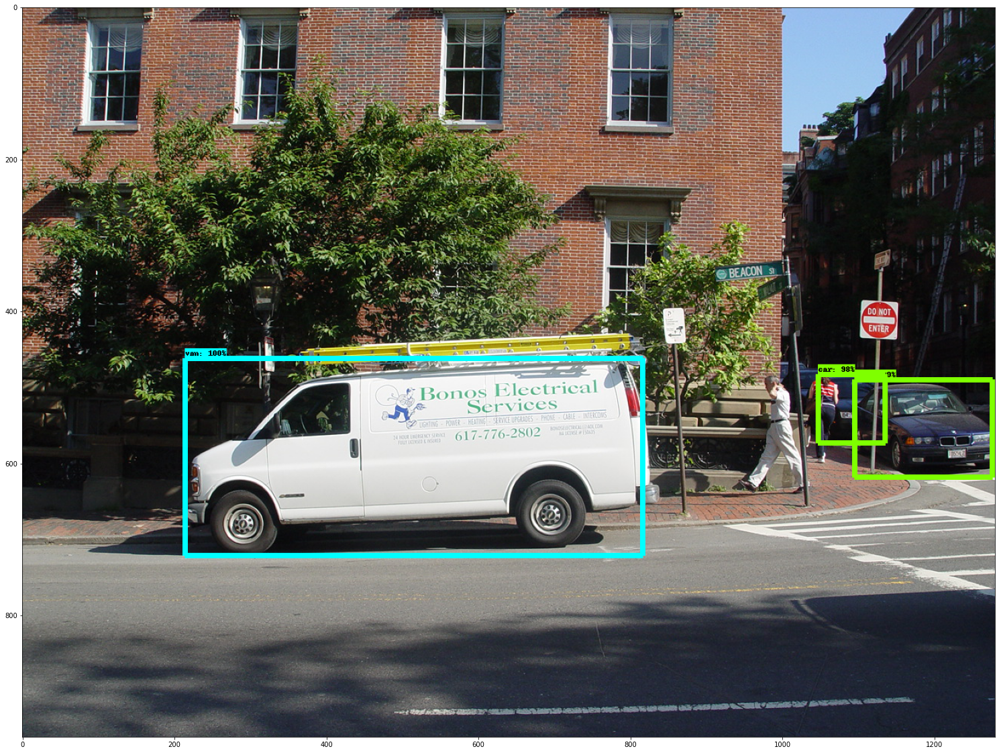

Completed Detection for images/test/SSDB01659.JPG... 

<Figure size 432x288 with 0 Axes>

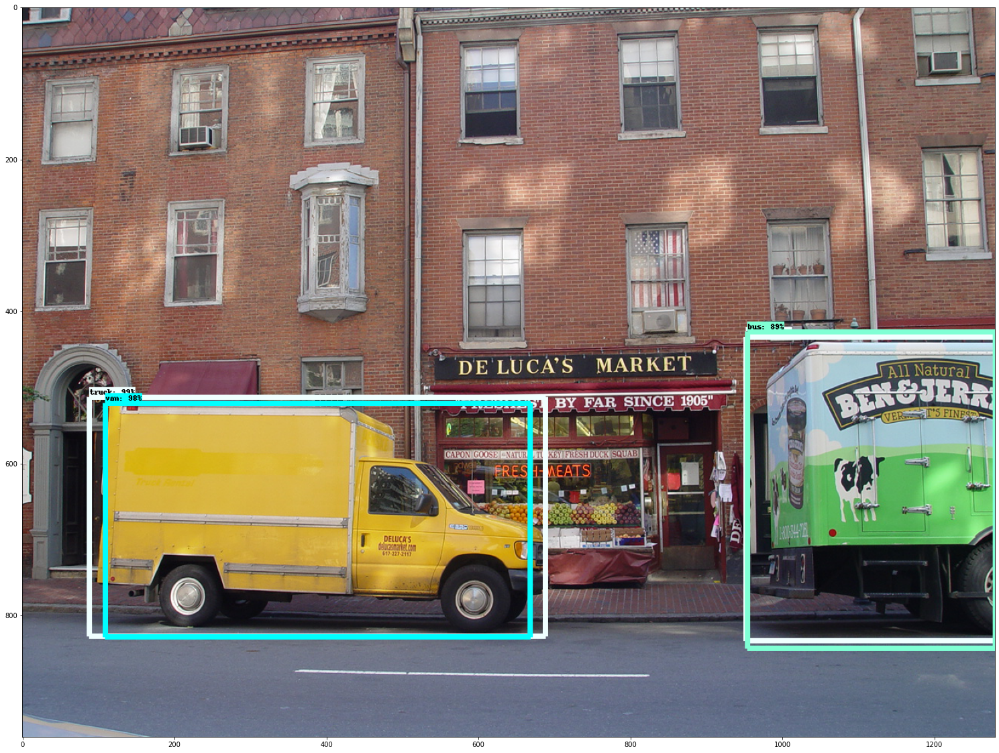

Completed Detection for images/test/SSDB00442.JPG... 

<Figure size 432x288 with 0 Axes>

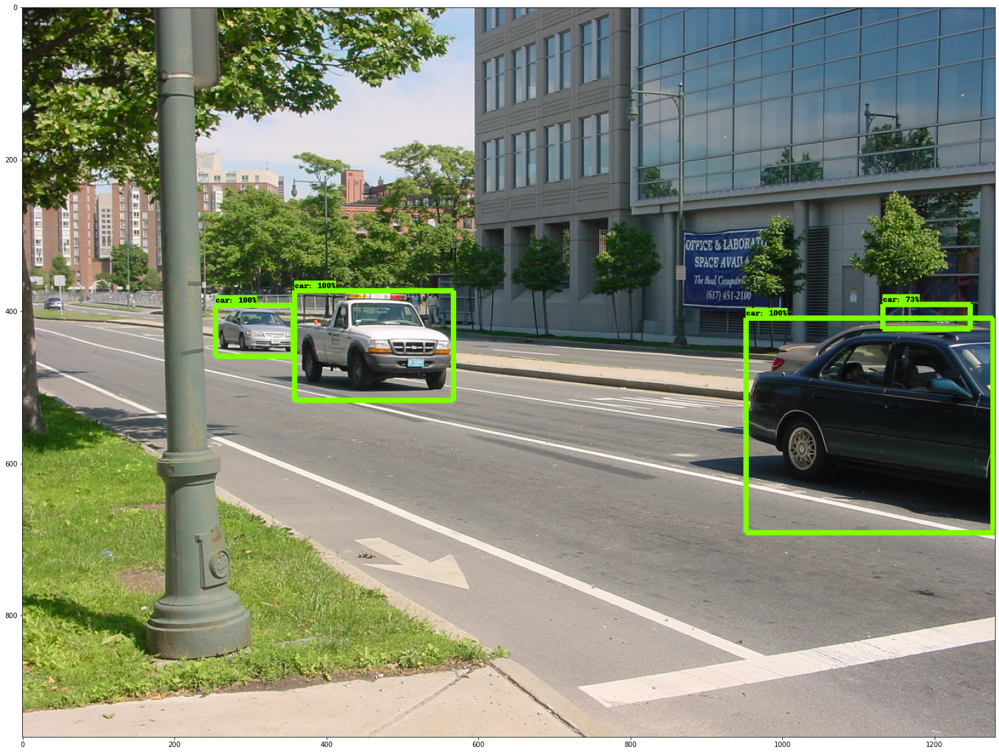

Completed Detection for images/test/SSDB01287.JPG... 

<Figure size 432x288 with 0 Axes>

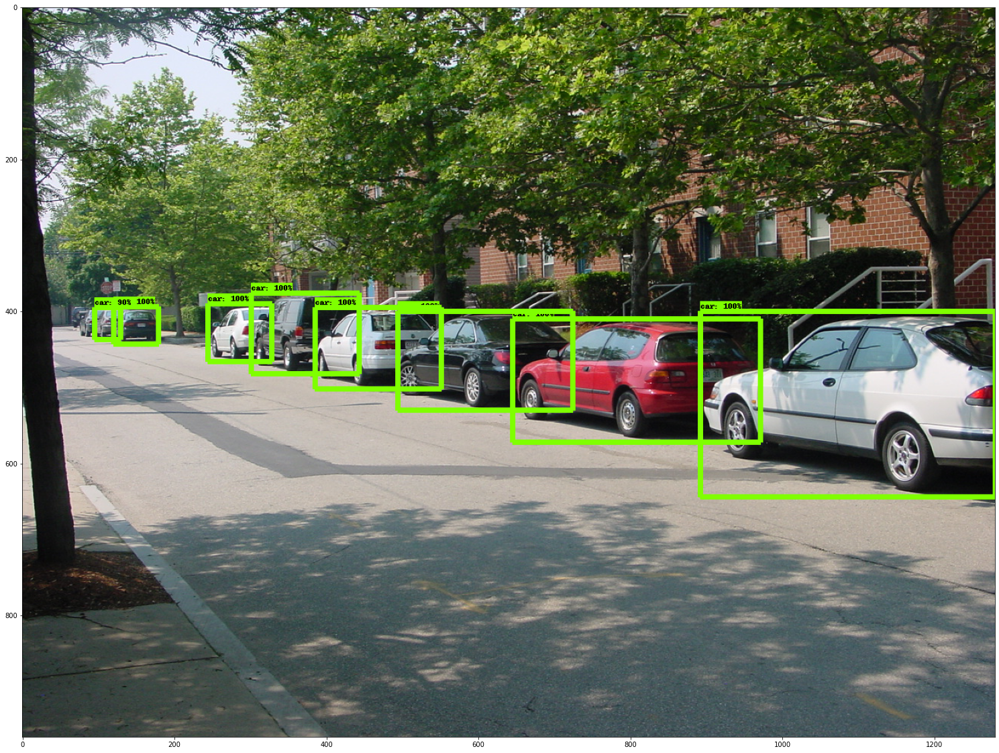

In [ ]:
#Running the actual detection



%cd '/content/gdrive/My Drive/TensorFlow/workspace/training_demo'

#loads the images in the test_images list above into an numpy array
def image_numpy_array(path):
    return np.array(Image.open(path))

for image in test_images:
  image_numpy=image_numpy_array(image)

  #Here the images used converted into tensors which are required for the detection models.
  tensor_convert=tf.convert_to_tensor(image_numpy)
  #allows for use of multiple images at once.
  tensor_convert=tensor_convert[tf.newaxis,...]

  model_detection=loaded_model(tensor_convert)


  num_detections=int(model_detection.pop('num_detections'))
  model_detection={key:value[0,:num_detections].numpy()
                    for key,value in model_detection.items()}
  model_detection['num_detections']=num_detections

  model_detection['detection_classes']= model_detection['detection_classes'].astype(np.int64)
  
  image_np_with_detections=image_numpy.copy()

  #configuration of the image to be shown
  viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,         # the image to be shown
            model_detection['detection_boxes'],    # shows the box for each prediction.
            model_detection['detection_classes'],  # shows the class of each prediction.
            model_detection['detection_scores'], #shows the accuracy score on each box.
            category_index,           #using the label map categories
            use_normalized_coordinates=True, # whether the boxes are also interpreted as coordinates.
            line_thickness = 7,      # changes thickness of the lines.
            max_boxes_to_draw=100,   #max number of boxes that will be drawn  .
            min_score_thresh=.6,  #will only print boxes where accuracy is above 60%.
            agnostic_mode=False)

  print('Completed Detection for {}... '.format(image), end='')


  # printing out the figures after configuration above.
  %matplotlib inline
  plt.figure()

  # larger image printed out
  plt.figure(figsize=(40,20)) 
  plt.imshow(image_np_with_detections)
  plt.show()
  